In [1]:
# Change width of Jupyter notebook
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# Section 4: Vector Space Models, BOW and TFIDF

# NOTE TO HOLDEN
CHECK online-hw5-bow-tfidf (1) ipynb, i wrote functions that combine the calculations for BOW, DTCM, TF, DF, IDF, TFIDF, etc. ... might be good to consolidate?

April 01 consolidates this even further...maybe use this for a consolidated final version?

This section draws heavily from Module 5 notebooks.

In [2]:
import pandas as pd
import nltk
import numpy as np

In [3]:
OHCO = ['industry_num','company_num','sent_num','token_num']

In [4]:
%%time
LIB = pd.read_csv("LIB.csv").set_index(OHCO[1])
TOKEN = pd.read_csv('TOKEN.csv').rename(columns={"Unnamed: 3":'token_num'}).set_index(OHCO)
VOCAB = pd.read_csv('VOCAB.csv').set_index('token_num')
DOC = pd.read_csv("DOC.csv").set_index(OHCO[:3])

CPU times: user 1.76 s, sys: 212 ms, total: 1.97 s
Wall time: 1.98 s


In [5]:
# count_method = 'c' # 'c' or 'n' # n = n tokens, c = distinct token (term) count
count_method = 'n' # actually going to use the number of times because i'm interested in importance of words
tf_method = 'raw' # sum, max, log, double_norm, raw, binary
tf_norm_k = .5 # only used for double_norm
idf_method = 'standard' # standard, max, smooth
gradient_cmap = 'GnBu' # YlGn, GnBu, YlGnBu; For tables; see https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html 

In [6]:
TOKEN.index.names = OHCO

## Add term_id to TOKEN table

We need to do this to combine the VOCAB and TOKEN tables more efficiently.

In [7]:
# this line adds a term_id column to the TOKEN table

TOKEN['term_id'] = TOKEN.term_str.map(VOCAB.reset_index().set_index('term_str').token_num)

In [8]:
TOKEN

pos_tuple   pos  \
industry_num company_num sent_num token_num                                
24           1102        0        0          ('ChiliSleep', 'NNP')   NNP   
                                  1                  ('is', 'VBZ')   VBZ   
                                  2                    ('a', 'DT')    DT   
                                  3                ('sleep', 'JJ')    JJ   
                                  4           ('technology', 'NN')    NN   
...                                                            ...   ...   
31           47196       5        14                 ('for', 'IN')    IN   
                                  15               ('our', 'PRP$')  PRP$   
                                  16           ('portfolio', 'NN')    NN   
                                  17                  ('of', 'IN')    IN   
                                  18          ('companies.', 'NN')    NN   

                                              token_str    term_str  \
industry_num company_num sent_num token_num                           
24           1102        0        0          ChiliSleep  chilisleep   
                                  1                  is          is   
                                  2                   a           a   
                                  3               sleep       sleep   
                                  4          technology  technology   
...                                                 ...         ...   
31           47196       5        14                for         for   
                                  15                our         our   
                                  16          portfolio   portfolio   
                                  17                 of          of   
                                  18         companies.   companies   

                                             Industry_Index  \
industry_num company_num sent_num token_num                   
24           1102        0        0                      24   
                                  1                      24   
                                  2                      24   
                                  3                      24   
                                  4                      24   
...                                                     ...   
31           47196       5        14                     31   
                                  15                     31   
                                  16                     31   
                                  17                     31   
                                  18                     31   

                                                           pos_max  \
industry_num company_num sent_num token_num                          
24           1102        0        0          ('ChiliSleep', 'NNP')   
                                  1                  ('is', 'VBZ')   
                                  2                    ('a', 'DT')   
                                  3                ('sleep', 'JJ')   
                                  4           ('technology', 'NN')   
...                                                            ...   
31           47196       5        14                 ('for', 'IN')   
                                  15               ('our', 'PRP$')   
                                  16           ('portfolio', 'NN')   
                                  17                  ('of', 'IN')   
                                  18          ('companies', 'NNS')   

                                                 Ind_Word_Tuple  \
industry_num company_num sent_num token_num                       
24           1102        0        0          ('ChiliSleep', 24)   
                                  1                  ('is', 24)   
                                  2                   ('a', 24)   
                                  3               ('sleep', 24)   
           

## Add Max POS to VOCAB

In [9]:
VOCAB['pos_max'] = TOKEN.groupby(['term_id', 'pos']).count().iloc[:,0].unstack().idxmax(1)

In [10]:
VOCAB

,term_str,n,num,stop,p_stem,pos_max
token_num,,,,,,
0,NaN,3343,0,0,NaN,CC
1,0,4,1,0,0,CD
2,00,1,1,0,00,CD
3,000,1,1,0,000,CD
4,0003,1,1,0,0003,VB
...,...,...,...,...,...,...
44847,你好,1,0,0,你好,NN
44848,도깨비,1,0,0,도깨비,IN
44849,ﬁnd,1,0,0,ﬁnd,VB


## Compare POS Stats in TOKEN and VOCAB

In [11]:
POS = TOKEN.pos.value_counts().to_frame().rename(columns={'pos':'n'})
POS.index.name = 'pos_id'

In [12]:
POS.head()

,n
pos_id,
NN,196524
NNP,102193
IN,93967
JJ,88209
DT,63730


In [13]:
# https://stackoverflow.com/questions/55132071/series-object-has-no-attribute-iplot/55132247
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

POS.sort_values('n',ascending=False).iplot(
    kind='bar',
    yTitle='Number of Words with POS designation',
    linecolor='black',
    xTitle='POS',
    title='Distribution: Number of Words per POS'
)

### POS_MAX

In [14]:
POS_MAX = VOCAB.pos_max.value_counts().to_frame().rename(columns={'pos_max':'n'})
POS_MAX.index.name = 'pos_id'

In [15]:
POS_MAX.head()

,n
pos_id,
NNP,18005
NN,9943
JJ,7698
NNS,2732
CD,1462


In [16]:
POS_MAX.sort_values('n',ascending=False).iplot(
    kind='bar',
    yTitle='Number of Words with POS designation',
    linecolor='black',
    xTitle='POS',
    title='Distribution: Number of Words per POS_Max'
)

In [17]:
POS['max_n'] = POS_MAX['n']

In [18]:
POS.head()

,n,max_n
pos_id,,
NN,196524,9943.0
NNP,102193,18005.0
IN,93967,130.0
JJ,88209,7698.0
DT,63730,21.0


In [19]:
import seaborn as sns
import plotly_express as px

fig = px.scatter(POS.reset_index(), x='n', y='max_n', text='pos_id')
fig.data[0].update(mode='text')
fig.show()

### Zipf's Law
$f \propto \frac{1}{r} $ ... frequency of a word is inversely proportional to its ranking

$k =  fr$ ... Zipf's constant = (frequency) x (rank of the word)

## Add Term Rank to VOCAB

In [20]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending=False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB = VOCAB.set_index('token_num')
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1

In [21]:
# Compute Zipf's K
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank

The term_rank shows the most frequent terms in VOCAB ordered from most to least frequent. The zipf_k is the Zipf's Constant (term rank x frequency)

In [22]:
VOCAB.head()
# this is ranked by most frequent rank

,term_rank,term_str,n,num,stop,p_stem,pos_max,zipf_k
token_num,,,,,,,,
3851,1,and,47740,0,1,and,CC,47740
39883,2,the,33537,0,1,the,DT,67074
40328,3,to,23607,0,1,to,TO,70821
28693,4,of,20177,0,1,of,IN,80708
20910,5,in,19717,0,1,in,IN,98585


## Histogram of Zipf's K

In [23]:
#px.histogram(VOCAB, 'zipf_k', marginal='box')
px.histogram(VOCAB, 'zipf_k', marginal='violin')

## Rank and N
Relationship between rank and frequency, we expect to get this power distribution shown below

In [24]:
# power distribution
px.scatter(VOCAB[VOCAB.term_rank <= 10000], x='term_rank', y='n', log_y=True, log_x=False, hover_name='term_str', color='pos_max')

## Rank and Zipf's K

In [25]:
px.scatter(VOCAB, x='term_rank', y='zipf_k', hover_name='term_str', hover_data=['n'], log_y=True, log_x=True, color='pos_max')

## Demo Rank Index
These values were taken from the Manning and Schuetze text and are orders of magnitude slices from our rank.

In [26]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000]

In [27]:
demo = VOCAB.loc[VOCAB.term_rank.isin(rank_index), ['term_str', 'term_rank', 'n', 'zipf_k', 'pos_max']]

In [28]:
demo.style.background_gradient(cmap=gradient_cmap)

# as rank increases, n decreases

# zipf_k has a distribution that bunches up where the mean/apex is around 'have'
# unfortunately, it looks like the words that are bunching up near the apex are stopwords
# we need to fix that if we want to get anything useful from this 


# well, apex of the zipf_k seems to be good but term_rank still has stopwords in it... is that a problem?

,term_str,term_rank,n,zipf_k,pos_max
token_num,,,,,
3851,and,1,47740,47740,CC
39883,the,2,33537,67074,DT
40328,to,3,23607,70821,TO
39874,that,10,7776,77760,WDT
3793,an,20,3900,78000,DT
39547,technology,30,2620,78600,NN
32015,products,40,2173,86920,NNS
9437,clients,50,1675,83750,NNS
19402,help,60,1419,85140,VB


## VOCAB Entropy
### Compute P of VOCAB
This is the prior, or marginal, probability of a term

In [29]:
%%time
VOCAB['p'] = VOCAB.n / VOCAB.n.sum()

CPU times: user 7.51 ms, sys: 2.13 ms, total: 9.64 ms
Wall time: 3.57 ms


### Compute Entropy of VOCAB

In [30]:
VOCAB['h'] = VOCAB.p * np.log2(1/VOCAB.p) # Self entropy of each word 
H = VOCAB.h.sum()
N_v = VOCAB.shape[0]
H_max = np.log2(N_v)
R = round(1 - (H/H_max), 2) * 100

In [31]:
print("H \t= {}\nH_max \t= {}\nR \t= {}%".format(H, H_max, int(R)))

H 	= 10.644034272936489
H_max 	= 15.452884697486617
R 	= 31%


The vocabulary has about 31% entropy (redundancy) 

# BOW
This is important for developing a document term matrix and computing TF-IDF

In [32]:
bag = 'industry_num'
bag

'industry_num'

In [33]:
# .count() returns a series
# .to_frame() turns it into a dataframe
# the columns were named incorrectly so we change it to 'n'
BOW = TOKEN.groupby([bag]+['term_id']).term_id.count()\
    .to_frame().rename(columns={'term_id':'n'})

In [34]:
# instead of number of times particular term exists in a bag,
# we convert that to a boolean and then to an integer 1/0

BOW['c'] = BOW.n.astype('bool').astype('int')
# will only show us the number one if term is present 

In [35]:
BOW.head()

# this bag has the term 0 164 times and term 21 only 1 times

n  c
industry_num term_id        
0            0        164  1
             21         1  1
             45         9  1
             46        10  1
             47        16  1

# Document-Term Matrix

We create a document-term count matrix. Note that we can create a matrix for any of the features in BOW. Also, see how the OHCO helps us distinguish between features and observation identity.

Note, these operations are slower than using `groupby()`.

### Create Count Matrix

In [36]:
%%time
DTCM = BOW[count_method].unstack().fillna(0).astype('int')

# select 'c' column from BOW and then unstack() it 
# pandas function that takes the last column from the multiindex and projects it onto the columns 
# so it turns the last column from a multiindex into a bunch of columns (rows to columns)


#### unstack() 
# unstacking functino takes the last column from the multiindex and projects it onto the columns
# so the values in the term_id from BOW above will be projected as column values 

CPU times: user 47.5 ms, sys: 5.62 ms, total: 53.1 ms
Wall time: 52 ms


In [37]:
DTCM.head()
# now this is a document term matrix, sparse 
# which means that here we see terms that don't exist and they are represnted as 0's

# what's great about this representation is that it shows us which words do and don't exist in certain industries
# this could be helpful later in our predictions / classifications because if a word never exists in an 
# industry then we can rule that out as an industry classification prediction

term_id,0,1,2,3,4,5,6,7,8,9,...,44842,44843,44844,44845,44846,44847,44848,44849,44850,44851
industry_num,,,,,,,,,,,,,,,,,,,,,
0,164,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,36,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,15,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,14,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Compute TF

In [38]:
%%time
print('TF method:', tf_method)
if tf_method == 'sum':
    TF = DTCM.T / DTCM.T.sum()
elif tf_method == 'max':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'log':
    TF = np.log10(1 + DTCM.T)
elif tf_method == 'raw':
    TF = DTCM.T
elif tf_method == 'double_norm':
    TF = DTCM.T / DTCM.T.max()
    TF = tf_norm_k + (1 - tf_norm_k) * TF[TF > 0]
elif tf_method == 'binary':
    TF = DTCM.T.astype('bool').astype('int')
TF = TF.T

TF method: raw
CPU times: user 5.09 ms, sys: 785 µs, total: 5.87 ms
Wall time: 5.23 ms


In [39]:
# we are using the 'raw' way of computing TF

TF.head()

term_id,0,1,2,3,4,5,6,7,8,9,...,44842,44843,44844,44845,44846,44847,44848,44849,44850,44851
industry_num,,,,,,,,,,,,,,,,,,,,,
0,164,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,36,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,15,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,14,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Compute DF

In [40]:
%%time
DF = DTCM[DTCM > 0].count()

# count up the instances: with every document where term value is greater than 0
# it's doing column-wise aggregation 
# returning a series of term-ids for each industry 

CPU times: user 297 ms, sys: 29.6 ms, total: 326 ms
Wall time: 301 ms


In [41]:
DF.head()

term_id
0    39
1     4
2     1
3     1
4     1
dtype: int64

### Compute IDF

In [42]:
N = DTCM.shape[0]

In [43]:
%%time
print('IDF method:', idf_method)
if idf_method == 'standard':
    IDF = np.log10(N / DF)
elif idf_method == 'max':
    IDF = np.log10(DF.max() / DF) 
elif idf_method == 'smooth':
    IDF = np.log10((1 + N) / (1 + DF)) + 1 
    
# we're using the 'standard' formula 

IDF method: standard
CPU times: user 1.71 ms, sys: 1.05 ms, total: 2.77 ms
Wall time: 1.2 ms


## Compute TF-IDF

In [44]:
TFIDF = TF * IDF

In [78]:
TFIDF.head()

term_id,0,1,2,3,4,5,6,7,8,9,...,44842,44843,44844,44845,44846,44847,44848,44849,44850,44851
industry_num,,,,,,,,,,,,,,,,,,,,,
0,1.803243,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.395834,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.164931,0.0,0.0,0.0,1.60206,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.098958,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.153935,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Moving things to their places

In [46]:
VOCAB['df'] = DF
VOCAB['idf'] = IDF

# every term in the document table will have a document frequency 

In [47]:
VOCAB.head()

,term_rank,term_str,n,num,stop,p_stem,pos_max,zipf_k,p,h,df,idf
token_num,,,,,,,,,,,,
3851,1,and,47740,0,1,and,CC,47740,0.053034,0.224701,40,0.0
39883,2,the,33537,0,1,the,DT,67074,0.037256,0.176831,40,0.0
40328,3,to,23607,0,1,to,TO,70821,0.026225,0.137757,40,0.0
28693,4,of,20177,0,1,of,IN,80708,0.022414,0.122818,40,0.0
20910,5,in,19717,0,1,in,IN,98585,0.021903,0.120747,40,0.0


In [48]:
BOW['tf'] = TF.stack()
BOW['tfidf'] = TFIDF.stack()

In [49]:
BOW.head()

# BOW is a series of terms
# the tfidf column shows the weighting of that word in that column in that bag 

n  c   tf     tfidf
industry_num term_id                       
0            0        164  1  164  1.803243
             21         1  1    1  1.602060
             45         9  1    9  1.124449
             46        10  1   10  1.396620
             47        16  1   16  0.927871

### Apply aggregates to VOCAB

In [50]:
%%time
VOCAB['tfidf_mean'] = TFIDF[TFIDF > 0].mean().fillna(0) # we are taking the mean value of all term frequency inverse document frequency
VOCAB['tfidf_sum'] = TFIDF.sum() # we are taking the sum of all term frequency inverse document frequency
VOCAB['tfidf_median'] = TFIDF[TFIDF > 0].median().fillna(0) # we are taking the median value of all term frequency inverse document frequency
VOCAB['tfidf_max'] = TFIDF.max() # we are taking the max value of all term frequency inverse document frequency

# sum is most important and what we will be using


CPU times: user 568 ms, sys: 9.77 ms, total: 578 ms
Wall time: 552 ms


### Observe results

The most significant terms here are bank, wine, staffing, medical, students, banking, etc.

This is interesting to see but it's not exactly helpful in our ultimate goal of classifying companies into industries based on their descriptions. Understanding a term's significance within the corpus isn't what we're looking for, we need to understand a term's significance within the corpus of industry-specific company descriptions.

In [51]:
VOCAB.sort_values('tfidf_sum', ascending=False).head(50).style.background_gradient(cmap=gradient_cmap)

,term_rank,term_str,n,num,stop,p_stem,pos_max,zipf_k,p,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
token_num,,,,,,,,,,,,,,,,
5508,102,bank,908,0,0,bank,NNP,92616,0.001009,0.010040,18,0.346787,17.493502,314.883037,0.693575,299.277601
43745,238,wine,457,0,0,wine,NN,108766,0.000508,0.005556,12,0.522879,19.912966,238.955587,1.045757,165.229684
37846,187,staffing,553,0,0,staf,VBG,103411,0.000614,0.006554,15,0.425969,15.704047,235.560709,1.277906,207.020804
25627,95,medical,949,0,0,medic,JJ,90155,0.001054,0.010426,23,0.240332,9.916314,228.075215,1.441993,155.975569
38423,120,students,829,0,0,student,NNS,99480,0.000921,0.009287,22,0.259637,9.783606,215.239330,1.038549,188.496687
5515,163,banking,617,0,0,bank,NN,100571,0.000685,0.007204,18,0.346787,11.887104,213.967879,0.693575,200.443167
21595,67,insurance,1242,0,0,insur,NN,83214,0.001380,0.013109,27,0.170696,7.852026,212.004714,0.853481,173.939455
24295,358,loans,322,0,0,loan,NNS,115276,0.000358,0.004095,9,0.647817,23.177470,208.597229,1.295635,188.514887
30067,197,patients,532,0,0,patient,NNS,104804,0.000591,0.006338,17,0.371611,11.629241,197.697089,1.114833,159.792760


## Visualize 
### Rank and TFIDF Mean

We are looking for something that curves where the stuff at the top is going to be considered significant. 

In [52]:
px.scatter(VOCAB, x='term_rank', y='tfidf_mean', hover_name='term_str', hover_data=['n'], color='pos_max', 
           log_x=False, log_y=False)

# if we use tfidf_mean then we don't succeed because it keeps on increasing

That TFIDF mean wasn't what we were looking for. Let's try sum.

### Rank and TFIDF Sum

In [53]:
px.scatter(VOCAB, x='term_rank', y='tfidf_sum', hover_name='term_str', hover_data=['n'], color='pos_max')

# this is an improvement because we start with a big increase and then a gradual decrease

This is closer to what we are looking for but it's interesting to see the distribution of the TFIDF_sum being so spaced out. What about taking the log?

### Log Rank and Log TFIDF Sum

In [54]:
px.scatter(VOCAB, x='term_rank', y='tfidf_sum', hover_name='term_str', hover_data=['n'], color='pos_max', 
           log_x=True, log_y=True)

# here we go! this is closer to what we are looking for

### TFIDF Mean and Sum

In [55]:
px.scatter(VOCAB, x='tfidf_mean', y='tfidf_sum', hover_name='term_str', color='pos_max')

# tfidf_sum is more useful to us than tfidf_mean
# but here is the relationship between the two, which is helpful to see 

### Show Demo Table with TFIDF

In [56]:
demo2 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), ['term_str', 'pos_max', 'term_rank', 'n', 'zipf_k', 'tfidf_mean', 'tfidf_sum', 'tfidf_max']]

In [57]:
demo2.style.background_gradient(cmap=gradient_cmap)

# the top of the curve in tfidf_mean has been moved to include words that aren't stopwords
# this is an improvement from the demo table we showed above that held mostly stopwords near the apex

# it's an improvement, but only slightly? maybe i'm interpreting this incorrectly but the tfidf_sum
# seems to be performing almost on par with the zipf_k for this dataset 

# in the notebook we went through in class, tfidf_sum blew zipf_k out of the water, but i'm not seeing
# those drastic improvements here

,term_str,pos_max,term_rank,n,zipf_k,tfidf_mean,tfidf_sum,tfidf_max
token_num,,,,,,,,
3851,and,CC,1,47740,47740,0.000000,0.000000,0.000000
39883,the,DT,2,33537,67074,0.000000,0.000000,0.000000
40328,to,TO,3,23607,70821,0.000000,0.000000,0.000000
39874,that,WDT,10,7776,77760,2.192310,85.500108,14.502912
3793,an,DT,20,3900,78000,1.099538,42.881999,7.652787
39547,technology,NN,30,2620,78600,1.535899,58.364154,9.021940
32015,products,NNS,40,2173,86920,1.273858,48.406606,9.177875
9437,clients,NNS,50,1675,83750,2.775329,97.136511,30.735732
19402,help,VB,60,1419,85140,0.831847,31.610204,5.970074


In [58]:
px.scatter(demo2, x='term_rank', y='tfidf_sum', log_x=True, log_y=True, text='term_str', color='pos_max', size='n')

#### Now take TFIDF sum and use it as our metric to determine what is the top significant terms

In [59]:
VOCAB.sort_values('tfidf_sum', ascending=False).head(20).style.background_gradient(cmap=gradient_cmap)

# sort by tfidf_sum to see what our significant words are

,term_rank,term_str,n,num,stop,p_stem,pos_max,zipf_k,p,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
token_num,,,,,,,,,,,,,,,,
5508,102,bank,908,0,0,bank,NNP,92616,0.001009,0.010040,18,0.346787,17.493502,314.883037,0.693575,299.277601
43745,238,wine,457,0,0,wine,NN,108766,0.000508,0.005556,12,0.522879,19.912966,238.955587,1.045757,165.229684
37846,187,staffing,553,0,0,staf,VBG,103411,0.000614,0.006554,15,0.425969,15.704047,235.560709,1.277906,207.020804
25627,95,medical,949,0,0,medic,JJ,90155,0.001054,0.010426,23,0.240332,9.916314,228.075215,1.441993,155.975569
38423,120,students,829,0,0,student,NNS,99480,0.000921,0.009287,22,0.259637,9.783606,215.239330,1.038549,188.496687
5515,163,banking,617,0,0,bank,NN,100571,0.000685,0.007204,18,0.346787,11.887104,213.967879,0.693575,200.443167
21595,67,insurance,1242,0,0,insur,NN,83214,0.001380,0.013109,27,0.170696,7.852026,212.004714,0.853481,173.939455
24295,358,loans,322,0,0,loan,NNS,115276,0.000358,0.004095,9,0.647817,23.177470,208.597229,1.295635,188.514887
30067,197,patients,532,0,0,patient,NNS,104804,0.000591,0.006338,17,0.371611,11.629241,197.697089,1.114833,159.792760


#### Compared to if we used TFIDF mean:

In [60]:
VOCAB.sort_values('tfidf_mean', ascending=False).head(20).style.background_gradient(cmap=gradient_cmap)

# tfidf_mean is privileging words that only appear once
# which is NOT what we want
# ultimately, tfidf_sum is performing better so we'll probably end up using something like that

,term_rank,term_str,n,num,stop,p_stem,pos_max,zipf_k,p,h,df,idf,tfidf_mean,tfidf_sum,tfidf_median,tfidf_max
token_num,,,,,,,,,,,,,,,,
41232,2100,tutoring,50,0,0,tutor,NN,105000,0.000056,0.000785,1,1.602060,80.103000,80.103000,80.103000,80.103000
5487,2111,bancorp,50,0,0,bancorp,NNP,105550,0.000056,0.000785,1,1.602060,80.103000,80.103000,80.103000,80.103000
11209,2235,cpas,47,0,0,cpa,NNP,105045,0.000052,0.000743,1,1.602060,75.296820,75.296820,75.296820,75.296820
41233,2276,tutors,46,0,0,tutor,NNS,104696,0.000051,0.000729,1,1.602060,73.694760,73.694760,73.694760,73.694760
33620,2530,reinsurance,40,0,0,reinsur,NN,101200,0.000044,0.000642,1,1.602060,64.082400,64.082400,64.082400,64.082400
26790,2641,mortgages,38,0,0,mortgag,NN,100358,0.000042,0.000613,1,1.602060,60.878280,60.878280,60.878280,60.878280
11200,1335,cpa,87,0,0,cpa,NNP,116145,0.000097,0.001289,2,1.301030,56.594805,113.189610,56.594805,109.286520
42813,1523,vodka,75,0,0,vodka,NN,114225,0.000083,0.001129,2,1.301030,48.788625,97.577250,48.788625,89.771070
20855,3101,implants,30,0,0,implant,NNS,93030,0.000033,0.000496,1,1.602060,48.061800,48.061800,48.061800,48.061800


**Takeaway from that exploration:** TFIDF mean gives too much credit to infrequent words, TFIDF sum does a better job of producing actually significant words across the corpus (higher n values and generally more predictive significance)

## Word-Context Matrix Entropy

In [61]:
WCM = DTCM / DTCM.sum() # turn these into probabilities across the word axis
WCMh = WCM * np.log2(1/WCM) # then compute its entropy 

In [62]:
VOCAB['h2'] = WCMh.sum() # then sum it up 

<AxesSubplot:>

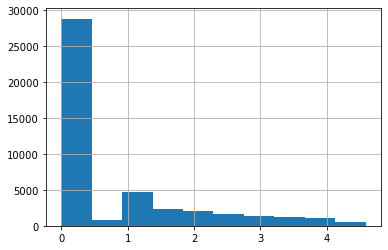

In [63]:
VOCAB['h2'].hist() 

# the word context matrix entropy way of looking at things
# look at words as having weights across documents 

# this looks like its going to be discriminative for us, which is good 

In [64]:
VOCAB['x_factor'] = np.log(VOCAB.term_rank) * VOCAB.h2

In [65]:
px.scatter(VOCAB, x='term_rank', y='x_factor', hover_name='term_str', color='pos_max', hover_data=['n'])

# a little more gradual of a hump that skews to the right

In [66]:
px.scatter(VOCAB, x='term_rank', y='x_factor', log_x=True, log_y=True, hover_name='term_str', color='pos_max', hover_data=['n'])

# this is a really nice curve that seems to perform well the function we are looking for

# if you zoom in at the apex you can see what the function has determined to be the most significant words

## NNS and NN fall out 

### Demo Table

In [67]:
demo3 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), ['term_str', 'pos_max', 'n', 'term_rank', 'zipf_k', 'tfidf_sum', 'h2', 'x_factor']]

In [68]:
demo3.style.background_gradient(cmap=gradient_cmap)

# looking at this demo table shows us that this model has a much broader curve (more dark blue)

,term_str,pos_max,n,term_rank,zipf_k,tfidf_sum,h2,x_factor
token_num,,,,,,,,
3851,and,CC,47740,1,47740,0.000000,4.414905,0.000000
39883,the,DT,33537,2,67074,0.000000,4.418561,3.062713
40328,to,TO,23607,3,70821,0.000000,4.386022,4.818537
39874,that,WDT,7776,10,77760,85.500108,4.364853,10.050445
3793,an,DT,3900,20,78000,42.881999,4.341715,13.006614
39547,technology,NN,2620,30,78600,58.364154,4.278513,14.552067
32015,products,NNS,2173,40,86920,48.406606,4.026523,14.853358
9437,clients,NNS,1675,50,83750,97.136511,3.748320,14.663516
19402,help,VB,1419,60,85140,31.610204,4.198445,17.189878


In [69]:
px.scatter(demo3, x='term_rank', y='x_factor', log_x=True, log_y=True, text='term_str', color='pos_max', size='n')

# good curve here 

#### Now that we have this data grouped, we can reduce the vocabulary

<AxesSubplot:ylabel='Frequency'>

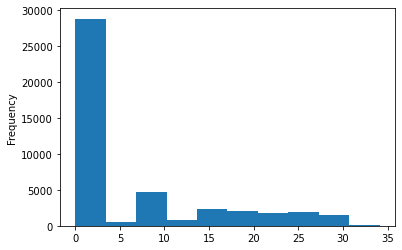

In [70]:
VOCAB.x_factor.plot.hist()

In [76]:
VOCAB.x_factor.iplot(
    kind='hist'
)

### Select Significant Terms based on X-factor

In [71]:
# key_col = 'tfidf_sum'
key_col = 'x_factor'
key_min = VOCAB[key_col].quantile(.9)
rank_min = 200 # this is a way of getting rid of stopwords 

In [72]:
SIGS = VOCAB.loc[(VOCAB[key_col] >= key_min) & (VOCAB.term_rank >= rank_min)].sort_values(key_col, ascending=False)

In [73]:
SIGS.shape[0] # this is about 1/10th of the original dataset size 

4473

In [74]:
SIGS[['pos_max', 'term_str', 'n', 'term_rank', 'zipf_k', 'df', 'idf', 'tfidf_sum','x_factor']].head(100).style.background_gradient(cmap=gradient_cmap)

,pos_max,term_str,n,term_rank,zipf_k,df,idf,tfidf_sum,x_factor
token_num,,,,,,,,,
599,CD,1987,32,2979,95328,21,0.279841,8.954902,34.119754
12311,VB,define,34,2875,97750,21,0.279841,9.514584,33.603513
12146,NN,decade,41,2494,102254,24,0.221849,9.095799,33.526898
41847,NNS,updates,43,2389,102727,23,0.240332,10.334283,33.168661
3277,NNS,alerts,35,2799,97965,20,0.301030,10.536050,32.918299
43950,NN,word,43,2403,103329,22,0.259637,11.164404,32.867666
15177,RB,especially,41,2500,102500,21,0.279841,11.473469,32.851424
41689,JJ,universal,40,2553,102120,21,0.279841,11.193628,32.825023
35711,VBG,seeing,19,4185,79515,16,0.397940,7.560860,32.791129


## Save work

In [75]:
VOCAB.to_csv('VOCAB2.csv')
TOKEN.to_csv('TOKEN2.csv')
BOW.to_csv('DOC2.csv')
DTCM.to_csv('DTCM.csv')
TFIDF.to_csv('TFIDF2.csv')
SIGS.to_csv('SIGS.csv')
WCM.to_csv('WCM.csv')